In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import plotly.express as px
from plotly.subplots import make_subplots
import nbformat
import folium
from folium import plugins
import json
import geojson
import geopandas as gpd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import folium
from folium.plugins import MarkerCluster
import matplotlib.colors as mcolors
from matplotlib.ticker import FuncFormatter
import geopandas as gpd

# Set visual styles for better aesthetics
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_context("talk")

In [2]:
# Print available styles
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'petroff10', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


In [3]:
df = pd.read_csv('/Users/areeb/Documents/Education/UCL/Cursor/Data Visualisation UCL/Group Assignment/powerplants (global) - global_power_plants.csv')
df.head()

,country code,country_long,name of powerplant,capacity in MW,latitude,longitude,primary_fuel,secondary fuel,other_fuel2,other_fuel3,start date,owner of plant,generation_gwh_2021,geolocation_source,estimated_generation_gwh_2021
0,AFG,Afghanistan,Kajaki Hydroelectric Power Plant Afghanistan,33.0,32.322,65.1190,Hydro,NaN,NaN,NaN,NaN,NaN,NaN,GEODB,123.77
1,AFG,Afghanistan,Kandahar DOG,10.0,31.670,65.7950,Solar,NaN,NaN,NaN,NaN,NaN,NaN,Wiki-Solar,18.43
2,AFG,Afghanistan,Kandahar JOL,10.0,31.623,65.7920,Solar,NaN,NaN,NaN,NaN,NaN,NaN,Wiki-Solar,18.64
3,AFG,Afghanistan,Mahipar Hydroelectric Power Plant Afghanistan,66.0,34.556,69.4787,Hydro,NaN,NaN,NaN,NaN,NaN,NaN,GEODB,225.06
4,AFG,Afghanistan,Naghlu Dam Hydroelectric Power Plant Afghanistan,100.0,34.641,69.7170,Hydro,NaN,NaN,NaN,NaN,NaN,NaN,GEODB,406.16


In [4]:
# Display information about your dataframe
print("Dataset Info:")
df.info()

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34936 entries, 0 to 34935
Data columns (total 15 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   country code                   34936 non-null  object 
 1   country_long                   34936 non-null  object 
 2   name of powerplant             34936 non-null  object 
 3   capacity in MW                 34936 non-null  float64
 4   latitude                       34936 non-null  float64
 5   longitude                      34936 non-null  float64
 6   primary_fuel                   34936 non-null  object 
 7   secondary fuel                 1944 non-null   object 
 8   other_fuel2                    276 non-null    object 
 9   other_fuel3                    92 non-null     object 
 10  start date                     17447 non-null  float64
 11  owner of plant                 20868 non-null  object 
 12  generation_gwh_2021            9

In [5]:
# We removed columns that are not going to aid in visualizations
# Our analysis is geared more towards power generation and the distribution in various countries
# Name of the powerplants, the owners and the source of the information is not relevant here

columns_to_drop = [2, 11, 13]
df = df.drop(df.columns[columns_to_drop], axis=1)

df.head(5)

,country code,country_long,capacity in MW,latitude,longitude,primary_fuel,secondary fuel,other_fuel2,other_fuel3,start date,generation_gwh_2021,estimated_generation_gwh_2021
0,AFG,Afghanistan,33.0,32.322,65.1190,Hydro,NaN,NaN,NaN,NaN,NaN,123.77
1,AFG,Afghanistan,10.0,31.670,65.7950,Solar,NaN,NaN,NaN,NaN,NaN,18.43
2,AFG,Afghanistan,10.0,31.623,65.7920,Solar,NaN,NaN,NaN,NaN,NaN,18.64
3,AFG,Afghanistan,66.0,34.556,69.4787,Hydro,NaN,NaN,NaN,NaN,NaN,225.06
4,AFG,Afghanistan,100.0,34.641,69.7170,Hydro,NaN,NaN,NaN,NaN,NaN,406.16


In [6]:
# Identify columns with missing values which may need to be imputed or excluded

# Set display options to show all rows
pd.set_option('display.max_rows', None)

# Check the count of missing values in each column
missing_values = df.isnull().sum()

# Filter columns with missing values and display them
missing_columns = missing_values[missing_values > 0]

# Sort columns by the number of missing values in descending order
missing_columns = missing_values[missing_values > 0].sort_values(ascending=False)
print(missing_columns)

other_fuel3                      34844
other_fuel2                      34660
secondary fuel                   32992
generation_gwh_2021              25277
estimated_generation_gwh_2021    18816
start date                       17489
dtype: int64


In [7]:
# Let's handle missing values based on the nature of each variable

# 1. Fuel-related columns (other_fuel3, other_fuel2, secondary_fuel)
# Since these are categorical and their absence likely means "no additional fuel", 
# we'll replace NaN with "None"
df['other_fuel3'] = df['other_fuel3'].fillna('None')
df['other_fuel2'] = df['other_fuel2'].fillna('None')
df['secondary fuel'] = df['secondary fuel'].fillna('None')

# 2. Generation data (generation_gwh_2021, estimated_generation_gwh_2021)
# For generation_gwh_2021, if we have estimated values, use those
df['generation_gwh_2021'] = df['generation_gwh_2021'].fillna(df['estimated_generation_gwh_2021'])
# For remaining NaN in both columns, we'll calculate based on capacity
# Assuming average capacity factor of 0.5 (common industry assumption)
capacity_factor = 0.5
hours_per_year = 8760

df['generation_gwh_2021'] = df['generation_gwh_2021'].fillna(
    df['capacity in MW'] * capacity_factor * hours_per_year / 1000
)
df['estimated_generation_gwh_2021'] = df['estimated_generation_gwh_2021'].fillna(
    df['capacity in MW'] * capacity_factor * hours_per_year / 1000
)

# 3. Start date
# Convert to datetime and fill missing values with median year by fuel type
df['start date'] = pd.to_numeric(df['start date'], errors='coerce')
median_start_by_fuel = df.groupby('primary_fuel')['start date'].transform('median')
df['start date'] = df['start date'].fillna(median_start_by_fuel)

# Create derived features
# 1. Age of power plant
current_year = 2025
df['plant_age'] = current_year - df['start date']

# 2. Generation efficiency (actual vs estimated)
df['generation_efficiency'] = df['generation_gwh_2021'] / df['capacity in MW']

# 3. Capacity categories
df['capacity_category'] = pd.cut(df['capacity in MW'], 
                               bins=[0, 10, 50, 100, 500, float('inf')],
                               labels=['Very Small', 'Small', 'Medium', 'Large', 'Very Large'])

# Basic statistical summary
print("\nBasic Statistical Summary:")
numerical_columns = ['capacity in MW', 'generation_gwh_2021', 'estimated_generation_gwh_2021', 'plant_age']
print(df[numerical_columns].describe())

# Display unique values in categorical columns
print("\nUnique values in primary_fuel:")
print(df['primary_fuel'].value_counts())

print("\nCapacity distribution by category:")
print(df['capacity_category'].value_counts())


Basic Statistical Summary:
       capacity in MW  generation_gwh_2021  estimated_generation_gwh_2021  \
count    34936.000000         34936.000000                   34936.000000   
mean       163.355148           645.533324                     673.190874   
std        489.636072          2137.595132                    2095.519959   
min          1.000000          -780.339000                       1.120000   
25%          4.900000             8.940750                      13.140000   
50%         16.745000            43.800000                      52.560000   
75%         75.344250           227.760000                     277.467500   
max      22500.000000         98550.000000                   98550.000000   

          plant_age  
count  34926.000000  
mean      23.765753  
std       19.582889  
min        5.000000  
25%        9.000000  
50%       15.000000  
75%       31.092315  
max      129.000000  

Unique values in primary_fuel:
primary_fuel
Solar             10665
Hydro      

In [8]:
# Create the initial visualization using plotly
fig = px.scatter_mapbox(df, 
                       lat='latitude', 
                       lon='longitude',
                       color='primary_fuel',
                       size='capacity in MW',
                       hover_data=['country_long', 'capacity in MW', 'primary_fuel'],
                       zoom=1,
                       title='Global Power Plant Distribution',
                       mapbox_style='carto-positron',
                       size_max=15,
                       opacity=0.7,
                       color_discrete_sequence=px.colors.qualitative.Set3)

# Update the layout for better visualization
fig.update_layout(
    title={
        'text': 'Global Power Plant Distribution by Fuel Type and Capacity',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(size=20)
    },
    mapbox=dict(
        zoom=1.5,
        center=dict(lat=20, lon=0)
    ),
    legend=dict(
        title='Primary Fuel Type',
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01,
        bgcolor='rgba(255, 255, 255, 0.8)'
    ),
    margin=dict(l=0, r=0, t=50, b=0)
)

# Show the plot
fig.show()

/var/folders/d4/bryqmbvs2bg1670mlb02s2gm0000gn/T/ipykernel_8789/4261354042.py:2: DeprecationWarning: *scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.scatter_mapbox(df,


In [9]:
# Create the enhanced visualization
fig = px.scatter_mapbox(df, 
                       lat='latitude', 
                       lon='longitude',
                       color='primary_fuel',
                       size='capacity in MW',
                       hover_data={
                           'latitude': False,
                           'longitude': False,
                           'capacity in MW': ':.2f',
                           'primary_fuel': True,
                           'country_long': True
                       },
                       zoom=1,
                       mapbox_style='carto-positron',
                       size_max=15,
                       opacity=0.7,
                       color_discrete_sequence=px.colors.qualitative.Prism)

# Update layout with enhanced features
fig.update_layout(
    title={
        'text': 'Global Power Plant Distribution by Fuel Type and Capacity',
        'y':0.98,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(size=20)
    },
    mapbox=dict(
        zoom=0.85,  # Adjusted zoom level to show entire world
        center=dict(lat=20, lon=0)  # Centered the map
    ),
    legend=dict(
        title='<b>Primary Fuel Type</b>',
        yanchor="top",
        y=0.95,
        xanchor="right",  # Moved legend to right side
        x=0.99,
        bgcolor='rgba(255, 255, 255, 0.85)',
        bordercolor="darkgray",
        borderwidth=1,
        itemsizing='constant',  # Consistent legend item sizes
        font=dict(size=11)
    ),
    margin=dict(l=0, r=0, t=50, b=0)
)



# Show the plot
fig.show()

/var/folders/d4/bryqmbvs2bg1670mlb02s2gm0000gn/T/ipykernel_8789/1535968389.py:2: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [10]:
# Import required libraries if not already imported
import geopandas as gpd
import json

# World Map
try:
    with open('media/world/world.geojson') as f:
        world = json.load(f)
    print("✓ World map loaded successfully")
except Exception as e:
    print(f"Error loading world map: {e}")

# US States Map
try:
    with open('media/states-10m.json') as f:
        us_states = json.load(f)
    print("✓ US states map loaded successfully")
except Exception as e:
    print(f"Error loading US states map: {e}")

# US Counties Map
try:
    with open('media/counties-10m.json') as f:
        us_counties = json.load(f)
    print("✓ US counties map loaded successfully")
except Exception as e:
    print(f"Error loading US counties map: {e}")

# US Cities Map
try:
    with open('media/us_cities/us_cities.geojson') as f:
        us_cities = json.load(f)
    print("✓ US cities map loaded successfully")
except Exception as e:
    print(f"Error loading US cities map: {e}")

# China Map
try:
    with open('media/china.json') as f:
        china = json.load(f)
    print("✓ China map loaded successfully")
except Exception as e:
    print(f"Error loading China map: {e}")

# Create a dictionary of all loaded maps for easy access
map_data = {
    'world': world,
    'us_states': us_states,
    'us_counties': us_counties,
    'us_cities': us_cities,
    'china': china
}

print("\nAll available maps:", list(map_data.keys()))

✓ World map loaded successfully
✓ US states map loaded successfully
✓ US counties map loaded successfully
✓ US cities map loaded successfully
✓ China map loaded successfully

All available maps: ['world', 'us_states', 'us_counties', 'us_cities', 'china']


In [11]:
# 2. Choropleth map of total capacity by country
capacity_by_country = df.groupby('country_long')['capacity in MW'].sum().reset_index()

fig = px.choropleth(capacity_by_country,
                    locations=df['country code'].unique(),
                    locationmode='ISO-3',
                    color='capacity in MW',
                    hover_name='country_long',
                    title='Total Power Plant Capacity by Country (MW)',
                    color_continuous_scale='Viridis')

fig.update_layout(height=800,
                 title_x=0.5)
fig.show()


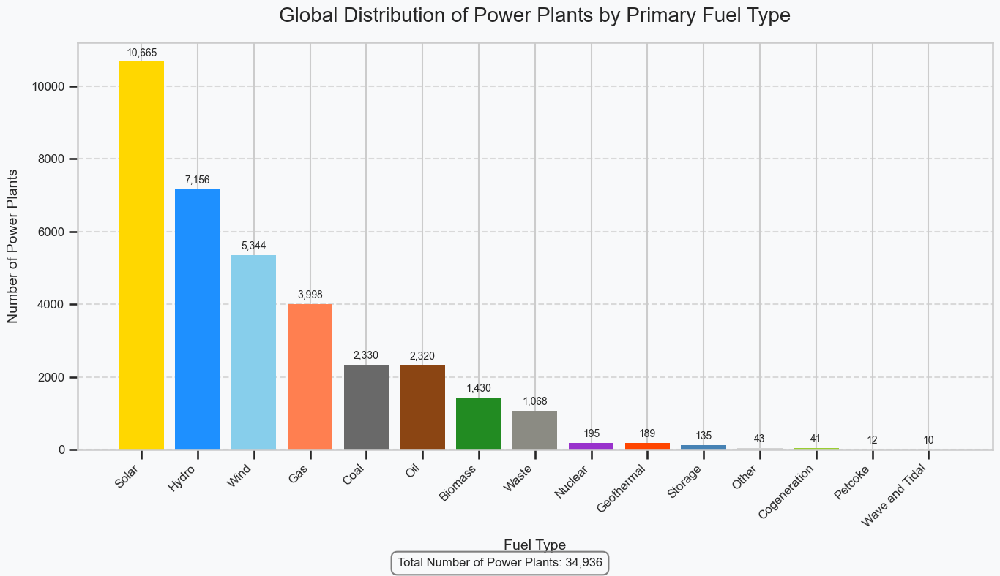

In [12]:
# Define a custom color palette for different fuel types
fuel_colors = {
    'Solar': '#FFD700',  # Gold
    'Hydro': '#1E90FF',  # Blue
    'Wind': '#87CEEB',   # Sky Blue
    'Coal': '#696969',   # Dark Gray
    'Gas': '#FF7F50',    # Coral
    'Oil': '#8B4513',    # Saddle Brown
    'Nuclear': '#9932CC', # Purple
    'Biomass': '#228B22', # Forest Green
    'Waste': '#8B8B83',  # Light Gray
    'Geothermal': '#FF4500', # Orange Red
    'Wave and Tidal': '#00FFFF', # Cyan
    'Petcoke': '#A52A2A', # Brown
    'Cogeneration': '#9ACD32', # Yellow Green
    'Storage': '#4682B4', # Steel Blue
    'Other': '#D3D3D3'   # Light Gray
}

# Count power plants by primary fuel type and sort by count
fuel_counts = df['primary_fuel'].value_counts().reset_index()
fuel_counts.columns = ['Fuel Type', 'Count']
fuel_counts = fuel_counts.sort_values('Count', ascending=False)

# Create a more sophisticated bar chart
plt.figure(figsize=(14, 8))
bars = plt.bar(
    fuel_counts['Fuel Type'], 
    fuel_counts['Count'],
    color=[fuel_colors.get(fuel, '#D3D3D3') for fuel in fuel_counts['Fuel Type']]
)

# Add data labels
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 100,
             f'{height:,.0f}',
             ha='center', va='bottom', rotation=0, fontsize=10)

# Add a title and labels with better styling
plt.title('Global Distribution of Power Plants by Primary Fuel Type', fontsize=20, pad=20)
plt.xlabel('Fuel Type', fontsize=14, labelpad=10)
plt.ylabel('Number of Power Plants', fontsize=14, labelpad=10)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Add gridlines for easier reading of values
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add some context as annotation
total_plants = fuel_counts['Count'].sum()
plt.figtext(0.5, 0.01, f'Total Number of Power Plants: {total_plants:,}', 
            ha='center', fontsize=12, bbox=dict(facecolor='none', edgecolor='gray', boxstyle='round,pad=0.5'))

# Add a subtle background color
ax = plt.gca()
ax.set_facecolor('#f8f9fa')
fig = plt.gcf()
fig.patch.set_facecolor('#f8f9fa')

plt.tight_layout()
plt.show()

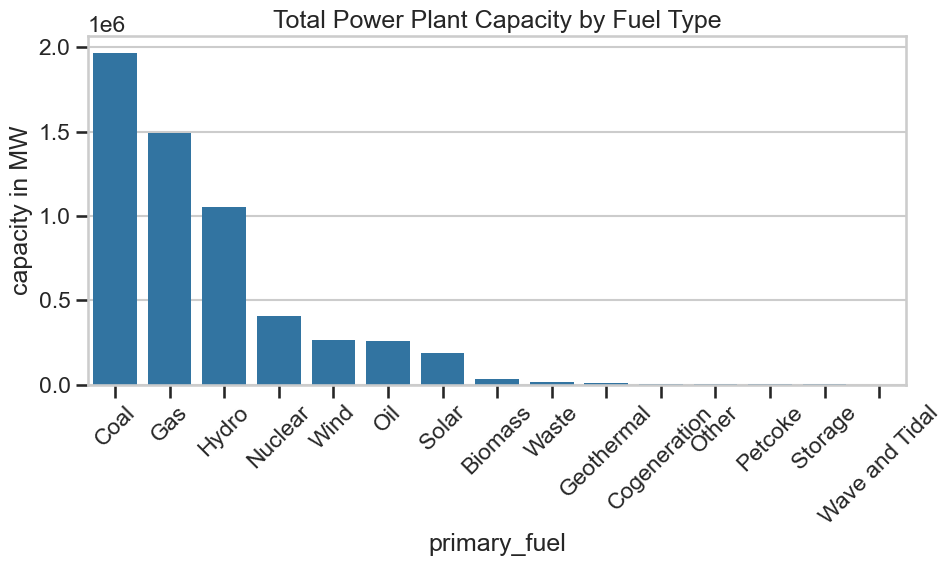

In [13]:
# Calculate total capacity by fuel type
capacity_by_fuel = df.groupby('primary_fuel')['capacity in MW'].sum().reset_index()
capacity_by_fuel = capacity_by_fuel.sort_values('capacity in MW', ascending=False)

# Create a simple bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x='primary_fuel', y='capacity in MW', data=capacity_by_fuel)
plt.title('Total Power Plant Capacity by Fuel Type')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [14]:
# Create a more sophisticated interactive map with clustered markers
# Filter out rows with missing lat/long values
map_df = df.dropna(subset=['latitude', 'longitude'])

# Create a base map centered on the world
world_map = folium.Map(location=[20, 0], zoom_start=2, tiles='CartoDB positron')

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(world_map)

# Define color mapping for different fuel types
fuel_type_colors = {
    'Solar': '#FFD700',
    'Hydro': '#1E90FF',
    'Wind': '#87CEEB',
    'Coal': '#696969',
    'Gas': '#FF7F50',
    'Oil': '#8B4513',
    'Nuclear': '#9932CC',
    'Biomass': '#228B22',
    'Other': '#D3D3D3'
}

# Sample the data to avoid browser performance issues (adjust the sample size as needed)
sample_size = min(5000, len(map_df))
map_df_sample = map_df.sample(sample_size, random_state=42)

# Add markers to the map
for idx, row in map_df_sample.iterrows():
    fuel_type = row['primary_fuel']
    color = fuel_type_colors.get(fuel_type, '#D3D3D3')
    
    # Create a custom popup with plant information
    popup_html = f"""
    <div style="width: 200px">
        <h4 style="color:#333; margin-bottom: 5px;">Power Plant Details</h4>
        <hr style="margin: 5px 0;">
        <p><b>Country:</b> {row['country_long']}</p>
        <p><b>Fuel Type:</b> {fuel_type}</p>
        <p><b>Capacity:</b> {row['capacity in MW']:.2f} MW</p>
    </div>
    """
    
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=folium.Popup(popup_html, max_width=300)
    ).add_to(marker_cluster)

# Add a title to the map
title_html = '''
<div style="position: fixed; 
            top: 10px; left: 50px; width: 500px; height: 40px; 
            background-color: white; border-radius: 5px; box-shadow: 0 0 5px rgba(0,0,0,0.2);
            z-index: 900; font-size: 18px; padding: 10px; text-align: center;">
    <b>Global Distribution of Power Plants</b>
</div>
'''
world_map.get_root().html.add_child(folium.Element(title_html))

# Add a legend
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; right: 50px; width: 150px;
            background-color: white; border-radius: 5px; box-shadow: 0 0 5px rgba(0,0,0,0.2);
            z-index: 900; padding: 10px;">
    <p style="margin-bottom: 5px; font-weight: bold;">Fuel Types</p>
'''

for fuel, color in fuel_type_colors.items():
    legend_html += f'''
    <div style="display: flex; align-items: center; margin-bottom: 3px;">
        <div style="background-color: {color}; width: 15px; height: 15px; border-radius: 50%; margin-right: 5px;"></div>
        <p style="margin: 0; font-size: 12px;">{fuel}</p>
    </div>
    '''

legend_html += '</div>'
world_map.get_root().html.add_child(folium.Element(legend_html))

# Display the map
world_map

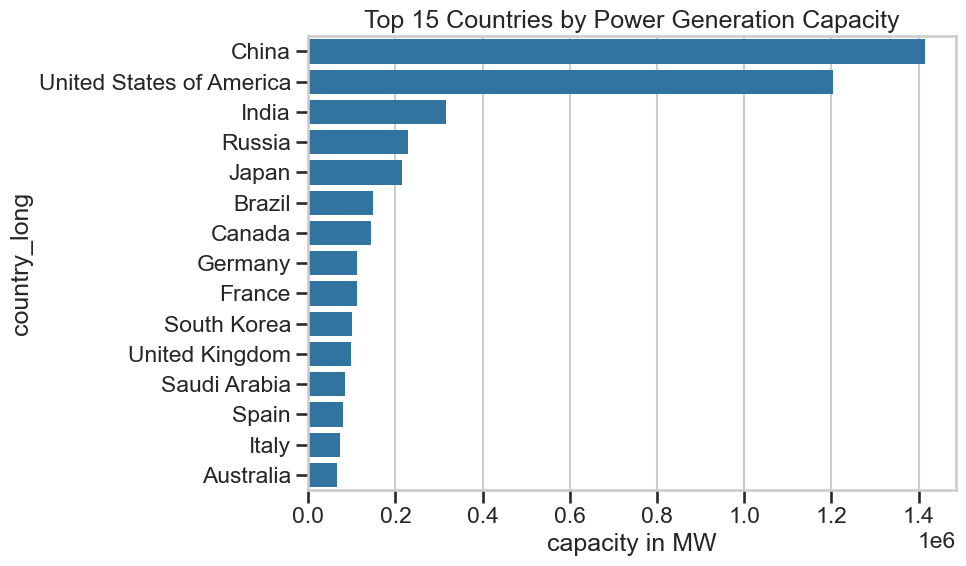

In [15]:
# Calculate total capacity by country
capacity_by_country = df.groupby('country_long')['capacity in MW'].sum().reset_index()
capacity_by_country = capacity_by_country.sort_values('capacity in MW', ascending=False).head(15)

# Create a simple bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x='capacity in MW', y='country_long', data=capacity_by_country)
plt.title('Top 15 Countries by Power Generation Capacity')
plt.tight_layout()
plt.show()

In [16]:
# Calculate total capacity by country
capacity_by_country = df.groupby('country_long')['capacity in MW'].sum().reset_index()
capacity_by_country = capacity_by_country.sort_values('capacity in MW', ascending=False).head(15)
capacity_by_country.columns = ['Country', 'Capacity (MW)']

# Calculate the percentage of global capacity
total_global_capacity = df['capacity in MW'].sum()
capacity_by_country['Global Share (%)'] = (capacity_by_country['Capacity (MW)'] / total_global_capacity * 100).round(1)

# Create a diverging color palette for the bars
colors = px.colors.sequential.Viridis[::-1]  # Reverse for better visual gradient

# Create an enhanced horizontal bar chart
fig = px.bar(
    capacity_by_country,
    x='Capacity (MW)',
    y='Country',
    orientation='h',
    color='Capacity (MW)',
    color_continuous_scale=colors,
    text=capacity_by_country.apply(lambda row: f"{row['Capacity (MW)']:,.0f} MW ({row['Global Share (%)']:,.1f}%)", axis=1),
    height=600
)

# Update layout for better aesthetics
fig.update_layout(
    title={
        'text': 'Top 15 Countries by Power Generation Capacity',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 22}
    },
    xaxis_title='Installed Capacity (MW)',
    yaxis_title=None,
    yaxis={'categoryorder':'total ascending'},
    plot_bgcolor='white',
    coloraxis_showscale=False,
    hoverlabel={'bgcolor': 'white', 'font_size': 14},
    margin=dict(l=20, r=20, t=80, b=20)
)

# Format x-axis with comma separator
fig.update_xaxes(
    tickformat=',',
    title_font={'size': 14},
    showgrid=True,
    gridwidth=0.5,
    gridcolor='#EEEEEE'
)

# Add annotations
total_shown = capacity_by_country['Capacity (MW)'].sum()
percentage_shown = (total_shown / total_global_capacity * 100).round(1)

fig.add_annotation(
    x=0.5,
    y=-0.15,
    xref='paper',
    yref='paper',
    text=f"These 15 countries represent {percentage_shown}% of global power generation capacity ({total_shown:,.0f} MW out of {total_global_capacity:,.0f} MW)",
    showarrow=False,
    font=dict(size=12),
    align='center',
    bgcolor='rgba(255, 255, 255, 0.8)',
    bordercolor='gray',
    borderwidth=1,
    borderpad=4
)

# Adjust text position and appearance
fig.update_traces(
    textposition='outside',
    textfont_size=12,
    hovertemplate='<b>%{y}</b><br>Capacity: %{x:,.0f} MW<br>Global Share: %{customdata[0]}%<extra></extra>',
    customdata=capacity_by_country[['Global Share (%)']]
)

fig.show()

In [17]:
# Get top 10 countries by capacity
top_countries = df.groupby('country_long')['capacity in MW'].sum().nlargest(10).index

# Filter for those countries
top_countries_df = df[df['country_long'].isin(top_countries)]

# Create a summarized dataframe of fuel mix by country
fuel_mix = top_countries_df.groupby(['country_long', 'primary_fuel'])['capacity in MW'].sum().reset_index()
pivot_df = fuel_mix.pivot(index='country_long', columns='primary_fuel', values='capacity in MW').fillna(0)

# Calculate total capacity for each country for sorting
country_totals = pivot_df.sum(axis=1).sort_values(ascending=False)
pivot_df = pivot_df.reindex(country_totals.index)

# Create a more detailed stacked bar chart using plotly
fig = go.Figure()

# Add each fuel type as a separate bar in the stack
for fuel in pivot_df.columns:
    if fuel in fuel_colors:
        color = fuel_colors[fuel]
    else:
        color = '#D3D3D3'  # Default gray for unlisted fuels
        
    fig.add_trace(go.Bar(
        x=pivot_df.index,
        y=pivot_df[fuel],
        name=fuel,
        marker_color=color,
        hovertemplate='<b>%{x}</b><br>' +
                      f'{fuel}: ' + '%{y:,.0f} MW<extra></extra>'
    ))

# Update layout for better aesthetics
fig.update_layout(
    title={
        'text': 'Energy Generation Mix in Top 10 Countries by Power Capacity',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 20}
    },
    xaxis_title=None,
    yaxis_title='Installed Capacity (MW)',
    barmode='stack',
    legend_title='Fuel Type',
    plot_bgcolor='white',
    hoverlabel={'bgcolor': 'white', 'font_size': 14},
    margin=dict(l=20, r=20, t=80, b=20),
    height=650
)

# Format y-axis with comma separated values
fig.update_yaxes(
    tickformat=',',
    title_font={'size': 14},
    showgrid=True,
    gridwidth=0.5,
    gridcolor='#EEEEEE'
)

# Add percentage annotations
for i, country in enumerate(pivot_df.index):
    country_total = pivot_df.loc[country].sum()
    
    # Calculate the cumulative sum for positioning annotations
    cumulative = 0
    for fuel in pivot_df.columns:
        fuel_capacity = pivot_df.loc[country, fuel]
        # Skip if the value is too small
        if fuel_capacity / country_total < 0.05:
            continue
            
        percentage = fuel_capacity / country_total * 100
        cumulative += fuel_capacity
        
        # Only add annotations for significant fuel sources
        if percentage >= 5:
            fig.add_annotation(
                x=i,
                y=cumulative - (fuel_capacity/2),
                text=f"{percentage:.1f}%",
                showarrow=False,
                font=dict(color='white' if fuel in ['Coal', 'Nuclear', 'Oil'] else 'black', size=10)
            )



fig.show()

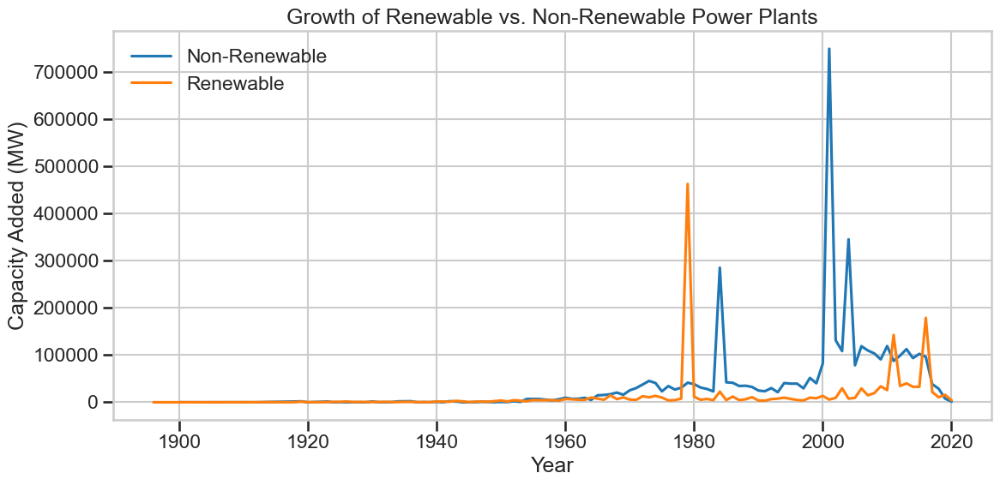

In [18]:
# Filter for plants with valid start date
time_df = df[df['start date'].notna()].copy()

# Create a renewable/non-renewable classification
renewable_fuels = ['Solar', 'Wind', 'Hydro', 'Biomass', 'Geothermal', 'Wave and Tidal']
time_df['type'] = time_df['primary_fuel'].apply(lambda x: 'Renewable' if x in renewable_fuels else 'Non-Renewable')

# Group by year and energy type
time_series = time_df.groupby([time_df['start date'].astype(int), 'type'])['capacity in MW'].sum().reset_index()
time_series.columns = ['Year', 'Type', 'Capacity (MW)']

# Create a simple time series
plt.figure(figsize=(12, 6))
for typ, group in time_series.groupby('Type'):
    plt.plot(group['Year'], group['Capacity (MW)'], label=typ)
plt.legend()
plt.title('Growth of Renewable vs. Non-Renewable Power Plants')
plt.xlabel('Year')
plt.ylabel('Capacity Added (MW)')
plt.tight_layout()
plt.show()

In [19]:
# 2. Fuel type distribution by continent/region
# First, let's create a continent mapping
continent_mapping = {
    'USA': 'North America',
    'CAN': 'North America',
    'GBR': 'Europe',
    'DEU': 'Europe',
    'CHN': 'Asia',
    'IND': 'Asia',
    # Add more mappings as needed
}

df['continent'] = df['country code'].map(continent_mapping)

fuel_by_continent = df.groupby(['continent', 'primary_fuel']).size().reset_index()
fuel_by_continent.columns = ['continent', 'primary_fuel', 'count']

fig = px.sunburst(fuel_by_continent,
                  path=['continent', 'primary_fuel'],
                  values='count',
                  title='Fuel Type Distribution by Continent')

fig.update_layout(title_x=0.5)
fig.show()

In [20]:
# 1. Global distribution of primary fuel types
fig = px.pie(df,
             names='primary_fuel',
             title='Global Distribution of Primary Fuel Types',
             color_discrete_sequence=px.colors.qualitative.Set3)

fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_x=0.5)
fig.show()

In [21]:
# 3. Average capacity by fuel type
avg_capacity = df.groupby('primary_fuel')['capacity in MW'].mean().sort_values(ascending=True)

fig = px.bar(avg_capacity,
             orientation='h',
             title='Average Power Plant Capacity by Fuel Type',
             color_discrete_sequence=['#3498db'])

fig.update_layout(title_x=0.5)
fig.show()

In [22]:
# 3. Geographic patterns in fuel type preferences
fig = px.scatter_mapbox(df,
                       lat='latitude',
                       lon='longitude',
                       color='primary_fuel',
                       size='capacity in MW',
                       animation_frame='primary_fuel',  # Creates animation by fuel type
                       title='Geographic Distribution of Fuel Types',
                       size_max=15,
                       zoom=1)

fig.update_layout(mapbox_style='carto-positron',
                 height=800,
                 title_x=0.5)
fig.show()

/var/folders/d4/bryqmbvs2bg1670mlb02s2gm0000gn/T/ipykernel_8789/3014449700.py:2: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [23]:
# Filter for US and China
us_china_df = df[df['country_long'].isin(['United States of America', 'China'])]

# Group by country and fuel type, calculate total capacity
capacity_by_fuel_country = us_china_df.groupby(['country_long', 'primary_fuel'])['capacity in MW'].sum().reset_index()

# Create a function to calculate percentages within each country
def add_percentage(df):
    result = df.copy()
    country_totals = df.groupby('country_long')['capacity in MW'].sum().reset_index()
    country_totals.columns = ['country_long', 'total_capacity']
    result = pd.merge(result, country_totals, on='country_long')
    result['percentage'] = (result['capacity in MW'] / result['total_capacity'] * 100).round(1)
    return result

capacity_by_fuel_country = add_percentage(capacity_by_fuel_country)

# Sort by fuel type and rename columns for clarity
capacity_by_fuel_country = capacity_by_fuel_country.sort_values(['country_long', 'capacity in MW'], ascending=[True, False])
capacity_by_fuel_country.columns = ['Country', 'Fuel Type', 'Capacity (MW)', 'Total Country Capacity (MW)', 'Percentage']

# Create enhanced grouped bar chart using plotly
fig = px.bar(
    capacity_by_fuel_country,
    x='Fuel Type',
    y='Capacity (MW)',
    color='Country',
    barmode='group',
    height=600,
    color_discrete_map={
        'United States of America': '#3366CC',  # Blue for USA
        'China': '#DC3912'  # Red for China
    },
    text=capacity_by_fuel_country['Percentage'].apply(lambda x: f'{x:.1f}%')
)

# Update layout for enhanced aesthetics
fig.update_layout(
    title={
        'text': 'Power Generation Capacity by Fuel Type: US vs China',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 22}
    },
    xaxis_title='Fuel Type',
    yaxis_title='Installed Capacity (MW)',
    plot_bgcolor='white',
    legend_title='Country',
    hoverlabel={'bgcolor': 'white', 'font_size': 14},
    margin=dict(l=20, r=20, t=80, b=20)
)

# Format y-axis with comma separator
fig.update_yaxes(
    tickformat=',',
    title_font={'size': 14},
    showgrid=True,
    gridwidth=0.5,
    gridcolor='#EEEEEE'
)

# Add a title to the x-axis
fig.update_xaxes(
    title_font={'size': 14},
    tickangle=45
)

# Update hover template
fig.update_traces(
    hovertemplate='<b>%{x}</b><br>' +
                  'Country: %{fullData.name}<br>' + 
                  'Capacity: %{y:,.0f} MW<br>' +
                  'Percentage: %{text}',
    textposition='outside'
)

# Add insights as annotations
us_top_fuel = capacity_by_fuel_country[capacity_by_fuel_country['Country'] == 'United States of America'].iloc[0]
china_top_fuel = capacity_by_fuel_country[capacity_by_fuel_country['Country'] == 'China'].iloc[0]

insights_text = (
    f"<b>Key Insights:</b><br>" +
    f"• China's top fuel source is {china_top_fuel['Fuel Type']} at {china_top_fuel['Percentage']}% of capacity<br>" +
    f"• US's top fuel source is {us_top_fuel['Fuel Type']} at {us_top_fuel['Percentage']}% of capacity<br>" +
    f"• Total capacity - China: {china_top_fuel['Total Country Capacity (MW)']:,.0f} MW, US: {us_top_fuel['Total Country Capacity (MW)']:,.0f} MW"
)

fig.add_annotation(
    x=1,
    y=0.5,
    xref="paper",
    yref="paper",
    text=insights_text,
    showarrow=False,
    font=dict(size=12),
    align="center",
    bgcolor="rgba(255, 255, 255, 0.8)",
    bordercolor="gray",
    borderwidth=1,
    borderpad=4
)

fig.show()

In [24]:
# Filter for US and China plants with start date and estimated generation data
us_china_time_df = df[
    (df['country_long'].isin(['United States of America', 'China'])) & 
    (df['start date'].notna()) & 
    (df['estimated_generation_gwh_2021'].notna()) &
    (df['start date'] >= 1950) & (df['start date'] <= 2021)  # Reasonable year range
]

# Group by country and start year, calculate total estimated generation
generation_by_year = us_china_time_df.groupby(['country_long', us_china_time_df['start date'].astype(int)])['estimated_generation_gwh_2021'].sum().reset_index()
generation_by_year.columns = ['Country', 'Year', 'Estimated Generation (GWh)']

# Calculate cumulative capacity over time for each country
cumulative_gen = pd.DataFrame()
for country in ['United States of America', 'China']:
    country_data = generation_by_year[generation_by_year['Country'] == country].sort_values('Year')
    country_data['Cumulative Generation (GWh)'] = country_data['Estimated Generation (GWh)'].cumsum()
    cumulative_gen = pd.concat([cumulative_gen, country_data])

# Create an enhanced time series graph using plotly
fig = go.Figure()

# Add lines for each country
for country, color in [('United States of America', '#3366CC'), ('China', '#DC3912')]:
    country_data = cumulative_gen[cumulative_gen['Country'] == country].sort_values('Year')
    
    # Add yearly generation as a bar chart
    fig.add_trace(
        go.Bar(
            x=country_data['Year'],
            y=country_data['Estimated Generation (GWh)'],
            name=f"{country} - Annual",
            marker_color=color,
            opacity=0.4,
            hovertemplate='<b>%{x}</b><br>' +
                          f'{country}<br>' +
                          'Annual Gen: %{y:,.0f} GWh<extra></extra>'
        )
    )
    
    # Add cumulative generation as a line
    fig.add_trace(
        go.Scatter(
            x=country_data['Year'],
            y=country_data['Cumulative Generation (GWh)'],
            mode='lines+markers',
            line=dict(color=color, width=3),
            name=f"{country} - Cumulative",
            marker=dict(size=6),
            hovertemplate='<b>%{x}</b><br>' +
                          f'{country}<br>' +
                          'Cumulative Gen: %{y:,.0f} GWh<extra></extra>'
        )
    )

# Update layout for better aesthetics
fig.update_layout(
    title={
        'text': 'Estimated Generation Growth Over Time: US vs China',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 22}
    },
    xaxis_title='Year',
    yaxis_title='Estimated Generation (GWh)',
    plot_bgcolor='white',
    legend_title='Country & Type',
    hoverlabel={'bgcolor': 'white', 'font_size': 14},
    margin=dict(l=20, r=20, t=80, b=20),
    height=600,
    barmode='overlay'
)

# Format axes
fig.update_xaxes(
    showgrid=True,
    gridwidth=0.5,
    gridcolor='#EEEEEE',
    dtick=10
)

fig.update_yaxes(
    showgrid=True,
    gridwidth=0.5,
    gridcolor='#EEEEEE',
    tickformat=',',
    title_font={'size': 14}
)

# Add vertical annotations for significant events
events = [
    {'year': 1978, 'event': 'China begins economic reforms', 'arrow': 'down'},
    {'year': 2001, 'event': 'China joins WTO', 'arrow': 'down'},
    {'year': 2011, 'event': 'Fukushima disaster affects global energy policy', 'arrow': 'down'},
]

for event in events:
    fig.add_vline(
        x=event['year'], 
        line_width=1, 
        line_dash="dash", 
        line_color="gray"
    )
    
    fig.add_annotation(
        x=event['year'],
        y=1.05,
        yref="paper",
        text=event['event'],
        showarrow=False,
        textangle=-90,
        font=dict(size=10),
        align="center",
        bgcolor="rgba(255, 255, 255, 0.8)"
    )

# Add annotation for key insights
fig.add_annotation(
    x=0.5,
    y=-0.2,
    xref="paper",
    yref="paper",
    text="China's rapid industrialization post-2000 led to unprecedented growth in power generation capacity,<br>overtaking the United States in cumulative estimated generation.",
    showarrow=False,
    font=dict(size=12),
    align="center",
    bgcolor="rgba(255, 255, 255, 0.8)",
    bordercolor="gray",
    borderwidth=1,
    borderpad=4
)

fig.show()

In [25]:
# Filter for US and China
us_china_df = df[df['country_long'].isin(['United States of America', 'China'])]

# Group by country and fuel type
treemap_data = us_china_df.groupby(['country_long', 'primary_fuel'])['capacity in MW'].sum().reset_index()
treemap_data.columns = ['Country', 'Fuel Type', 'Capacity (MW)']

# Calculate percentages within each country for labels
treemap_data['Country Total'] = treemap_data.groupby('Country')['Capacity (MW)'].transform('sum')
treemap_data['Percentage'] = (treemap_data['Capacity (MW)'] / treemap_data['Country Total'] * 100).round(1)
treemap_data['Label'] = treemap_data.apply(lambda x: f"{x['Fuel Type']}<br>{x['Capacity (MW)']:,.0f} MW<br>{x['Percentage']}%", axis=1)

# Create color mapping for consistency
country_colors = {
    'United States of America': 'blues',
    'China': 'reds'
}

# Create the treemap visualization
fig = px.treemap(
    treemap_data,
    path=['Country', 'Fuel Type'],
    values='Capacity (MW)',
    color='Country',
    color_discrete_map={
        'United States of America': '#3366CC',
        'China': '#DC3912'
    },
    hover_data=['Capacity (MW)', 'Percentage'],
    custom_data=['Percentage', 'Country Total', 'Label'],
    height=700
)

# Update layout for enhanced aesthetics
fig.update_layout(
    title={
        'text': 'Power Plant Capacity Distribution by Country and Fuel Type: US vs China',
        'y':0.98,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 22}
    },
    margin=dict(l=20, r=20, t=80, b=20),
    treemapcolorway=['#3366CC', '#DC3912']  # Blue for US, Red for China
)

# Update traces with better hover information and labels
fig.update_traces(
    hovertemplate='<b>%{label}</b><br>Capacity: %{value:,.0f} MW<br>Percentage: %{customdata[0]:.1f}%<extra></extra>',
    texttemplate='<b>%{label}</b><br>%{customdata[0]:.1f}%',
    textposition="middle center",
    textfont=dict(size=14)
)

# Add insights annotation
china_coal = treemap_data[(treemap_data['Country'] == 'China') & (treemap_data['Fuel Type'] == 'Coal')]['Percentage'].values[0]
us_gas = treemap_data[(treemap_data['Country'] == 'United States of America') & (treemap_data['Fuel Type'] == 'Gas')]['Percentage'].values[0]
us_coal = treemap_data[(treemap_data['Country'] == 'United States of America') & (treemap_data['Fuel Type'] == 'Coal')]['Percentage'].values[0]

insights_text = (
    f"<b>Key Insights:</b><br>" +
    f"• Coal dominates China's power capacity at {china_coal:.1f}%<br>" +
    f"• US relies on Gas ({us_gas:.1f}%) and Coal ({us_coal:.1f}%) for over half its capacity<br>" +
    f"• The power mix reflects different resource availability and policy priorities"
)

fig.add_annotation(
    x=0.5,
    y=-0.05,
    xref="paper",
    yref="paper",
    text=insights_text,
    showarrow=False,
    font=dict(size=12),
    align="center",
    bgcolor="rgba(255, 255, 255, 0.8)",
    bordercolor="gray",
    borderwidth=1,
    borderpad=4
)

fig.show()

In [26]:
# Filter data for US and China
us_china_df = df[df['country_long'].isin(['United States of America', 'China'])]

# Calculate percentage of capacity by fuel type for each country
fuel_mix = us_china_df.groupby(['country_long', 'primary_fuel'])['capacity in MW'].sum().reset_index()
country_totals = fuel_mix.groupby('country_long')['capacity in MW'].sum().reset_index()
country_totals.columns = ['country_long', 'total_capacity']
fuel_mix = pd.merge(fuel_mix, country_totals, on='country_long')
fuel_mix['percentage'] = (fuel_mix['capacity in MW'] / fuel_mix['total_capacity'] * 100).round(1)

# Keep only the top 7 fuel types for cleaner visualization
top_fuels = fuel_mix.groupby('primary_fuel')['capacity in MW'].sum().nlargest(7).index
fuel_mix_filtered = fuel_mix[fuel_mix['primary_fuel'].isin(top_fuels)]

# Pivot the data for radar chart
radar_data = fuel_mix_filtered.pivot(index='country_long', columns='primary_fuel', values='percentage').fillna(0)

# Create radar chart with plotly
categories = radar_data.columns.tolist()
fig = go.Figure()

# Add trace for US
fig.add_trace(go.Scatterpolar(
    r=radar_data.loc['United States of America'].values.tolist(),
    theta=categories,
    fill='toself',
    name='United States',
    line_color='#3366CC',
    fillcolor='rgba(51, 102, 204, 0.3)'
))

# Add trace for China
fig.add_trace(go.Scatterpolar(
    r=radar_data.loc['China'].values.tolist(),
    theta=categories,
    fill='toself',
    name='China',
    line_color='#DC3912',
    fillcolor='rgba(220, 57, 18, 0.3)'
))

# Update layout
fig.update_layout(
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, max(radar_data.max()) * 1.1]
        )
    ),
    title={
        'text': 'Energy Mix Comparison: US vs China (% of Total Capacity)',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 22}
    },
    height=600,
    width=800,
    showlegend=True,
    legend=dict(
        x=0.85,
        y=0.95,
        bgcolor='rgba(255, 255, 255, 0.8)',
        bordercolor='lightgrey',
        borderwidth=1
    )
)

# Add annotation with key insights
us_top = radar_data.loc['United States of America'].idxmax()
china_top = radar_data.loc['China'].idxmax()
us_top_value = radar_data.loc['United States of America', us_top]
china_top_value = radar_data.loc['China', china_top]

insights_text = (
    f"<b>Key Insights:</b><br>" +
    f"• China relies heavily on {china_top} ({china_top_value:.1f}% of capacity)<br>" +
    f"• US energy mix is more diversified with {us_top} leading ({us_top_value:.1f}%)<br>" +
    f"• US has stronger presence in gas, nuclear and solar<br>" +
    f"• China dominates in hydro and coal capacity"
)

fig.add_annotation(
    x=0.5,
    y=-0.15,
    xref="paper",
    yref="paper",
    text=insights_text,
    showarrow=False,
    font=dict(size=12),
    align="center",
    bgcolor="rgba(255, 255, 255, 0.8)",
    bordercolor="gray",
    borderwidth=1,
    borderpad=4
)

fig.show()

In [27]:
# Filter for US and China
us_china_df = df[df['country_long'].isin(['United States of America', 'China'])]

# Filter out extreme outliers if any (optional but recommended)
us_china_filtered = us_china_df[us_china_df['capacity in MW'] > 0]
us_china_filtered = us_china_filtered[us_china_filtered['capacity in MW'] < 10000]  # Cap at reasonable maximum

# Create enhanced violin plot using plotly
fig = px.violin(
    us_china_filtered,
    x='country_long',
    y='capacity in MW',
    color='country_long',
    color_discrete_map={
        'United States of America': '#3366CC',
        'China': '#DC3912'
    },
    box=True,
    points=False,  # Change to "outliers" if you want to see only outliers
    log_y=True,  # Log scale for better visualization of distribution
    labels={
        'country_long': 'Country',
        'capacity in MW': 'Capacity (MW)'
    },
    category_orders={"country_long": ["China", "United States of America"]}
)

# Update layout for better aesthetics
fig.update_layout(
    title={
        'text': 'Power Plant Size Distribution: US vs China',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 22}
    },
    xaxis_title=None,
    yaxis_title='Capacity (MW) - Log Scale',
    plot_bgcolor='white',
    legend_title='Country',
    showlegend=False,
    hoverlabel={'bgcolor': 'white', 'font_size': 14},
    margin=dict(l=20, r=120, t=80, b=20),
    height=600,
    width=900
)

# Add gridlines for better readability
fig.update_yaxes(
    showgrid=True,
    gridwidth=0.5,
    gridcolor='#EEEEEE',
    range=[0, 4]  # Set reasonable log range (10^0 to 10^4)
)

# Calculate and display statistics
us_stats = us_china_filtered[us_china_filtered['country_long'] == 'United States of America']['capacity in MW']
china_stats = us_china_filtered[us_china_filtered['country_long'] == 'China']['capacity in MW']

stats_text = (
    f"<b>US Statistics:</b><br>" +
    f"• Median: {us_stats.median():.1f} MW<br>" +
    f"• Mean: {us_stats.mean():.1f} MW<br>" +
    f"• Max: {us_stats.max():.1f} MW<br>" +
    f"• Plants > 1000 MW: {(us_stats > 1000).sum()} ({(us_stats > 1000).sum()/len(us_stats)*100:.1f}%)<br><br>" +
    f"<b>China Statistics:</b><br>" +
    f"• Median: {china_stats.median():.1f} MW<br>" +
    f"• Mean: {china_stats.mean():.1f} MW<br>" +
    f"• Max: {china_stats.max():.1f} MW<br>" +
    f"• Plants > 1000 MW: {(china_stats > 1000).sum()} ({(china_stats > 1000).sum()/len(china_stats)*100:.1f}%)"
)

fig.add_annotation(
    x=1.15,
    y=0.5,
    xref="paper",
    yref="paper",
    text=stats_text,
    showarrow=False,
    font=dict(size=12),
    align="left",
    bgcolor="rgba(255, 255, 255, 0.8)",
    bordercolor="gray",
    borderwidth=1,
    borderpad=4
)

# Add horizontal reference lines
fig.add_shape(
    type="line",
    x0=-0.5, x1=1.5,
    y0=100, y1=100,
    line=dict(color="gray", width=1, dash="dash"),
)
fig.add_annotation(
    x=1.02,
    y=100,
    text="100 MW",
    showarrow=False,
    font=dict(size=10),
    xanchor="left"
)

fig.add_shape(
    type="line",
    x0=-0.5, x1=1.5,
    y0=1000, y1=1000,
    line=dict(color="gray", width=1, dash="dash"),
)
fig.add_annotation(
    x=1.02,
    y=1000,
    text="1000 MW",
    showarrow=False,
    font=dict(size=10),
    xanchor="left"
)

# Add insights annotation
insight_text = "China tends to build larger power plants on average compared to the US,<br>reflecting their more recent infrastructure development and focus on economies of scale."

fig.add_annotation(
    x=0.5,
    y=-0.15,
    xref="paper",
    yref="paper",
    text=insight_text,
    showarrow=False,
    font=dict(size=12),
    align="center",
    bgcolor="rgba(255, 255, 255, 0.8)",
    bordercolor="gray",
    borderwidth=1,
    borderpad=4
)

fig.show()

In [28]:
# Import required libraries
import folium
from folium import plugins
import branca.colormap as cm

# Create separate dataframes for each country
us_data = us_china_df[us_china_df['country_long'] == 'United States of America']
china_data = us_china_df[us_china_df['country_long'] == 'China']

# Create separate maps for US and China power plants
def create_country_power_plant_map(country_data, country_name):
    # Create color maps for different fuel types
    fuel_colors = {
        'Coal': '#463E3F',
        'Gas': '#2E86C1',
        'Oil': '#873600',
        'Hydro': '#3498DB',
        'Nuclear': '#27AE60',
        'Solar': '#F4D03F',
        'Wind': '#85C1E9',
        'Biomass': '#28B463',
        'Waste': '#707B7C',
        'Geothermal': '#E74C3C',
        'Storage': '#8E44AD',
        'Other': '#BDC3C7'
    }
    
    # Set map center and zoom
    center_lat = country_data['latitude'].mean()
    center_lon = country_data['longitude'].mean()
    
    # Create the base map
    m = folium.Map(
        location=[center_lat, center_lon],
        zoom_start=4,
        tiles='cartodbpositron'
    )
    
    # Create a marker cluster
    marker_cluster = plugins.MarkerCluster().add_to(m)
    
    # Add markers for each power plant
    for idx, row in country_data.iterrows():
        # Create popup content
        popup_content = f"""
        <div style="width: 200px">
            <b>Power Plant Details:</b><br>
            Capacity: {row['capacity in MW']:.1f} MW<br>
            Fuel Type: {row['primary_fuel']}<br>
            Generation (2021): {row['generation_gwh_2021']:.1f} GWh
        </div>
        """
        
        # Calculate marker size based on capacity
        size = np.sqrt(row['capacity in MW']) / 5
        size = min(max(size, 3), 15)
        
        # Add circle marker
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=size,
            popup=folium.Popup(popup_content, max_width=300),
            color=fuel_colors.get(row['primary_fuel'], '#808080'),
            fill=True,
            fillOpacity=0.7,
            weight=1
        ).add_to(marker_cluster)
    
    # Add a legend
    legend_html = '''
    <div style="position: fixed; 
                bottom: 50px; 
                left: 50px; 
                z-index: 1000; 
                background-color: white; 
                padding: 10px; 
                border: 2px solid grey; 
                border-radius: 5px;">
    <h4>Fuel Types</h4>
    '''
    
    for fuel, color in fuel_colors.items():
        legend_html += f'''
        <div style="display: flex; align-items: center; margin-bottom: 5px;">
            <div style="background-color: {color}; 
                        width: 20px; 
                        height: 20px; 
                        margin-right: 5px; 
                        border-radius: 50%;"></div>
            <span>{fuel}</span>
        </div>
        '''
    
    legend_html += '</div>'
    m.get_root().html.add_child(folium.Element(legend_html))
    
    # Add title
    title_html = f'''
    <div style="position: fixed; 
                top: 10px; 
                left: 50%; 
                transform: translateX(-50%);
                z-index: 1000; 
                background-color: white; 
                padding: 10px; 
                border: 2px solid grey; 
                border-radius: 5px;">
        <h3 style="margin: 0;">{country_name} Power Plants Distribution</h3>
    </div>
    '''
    m.get_root().html.add_child(folium.Element(title_html))
    
    return m

# Create maps for both countries
us_map = create_country_power_plant_map(us_data, 'United States')
china_map = create_country_power_plant_map(china_data, 'China')

# Create heatmap visualization
def create_power_plant_heatmap(country_data, country_name):
    # Set map center and zoom
    center_lat = country_data['latitude'].mean()
    center_lon = country_data['longitude'].mean()
    
    # Create the base map
    m = folium.Map(
        location=[center_lat, center_lon],
        zoom_start=4,
        tiles='cartodbpositron'
    )
    
    # Prepare heat data
    heat_data = [[row['latitude'], 
                  row['longitude'], 
                  min(float(row['capacity in MW']), 1000)] # Cap the values to prevent extreme variations
                 for idx, row in country_data.iterrows()]
    
    # Add heat map layer
    plugins.HeatMap(
        heat_data,
        radius=15,
        blur=10,
        max_zoom=13,
    ).add_to(m)
    
    # Add title
    title_html = f'''
    <div style="position: fixed; 
                top: 10px; 
                left: 50%; 
                transform: translateX(-50%);
                z-index: 1000; 
                background-color: white; 
                padding: 10px; 
                border: 2px solid grey; 
                border-radius: 5px;">
        <h3 style="margin: 0;">{country_name} Power Plant Density Heatmap</h3>
    </div>
    '''
    m.get_root().html.add_child(folium.Element(title_html))
    
    return m

# Create heatmaps for both countries
us_heatmap = create_power_plant_heatmap(us_data, 'United States')
china_heatmap = create_power_plant_heatmap(china_data, 'China')

# Display maps in the notebook
display(us_map)
display(china_map)
display(us_heatmap)
display(china_heatmap)